# Content List

## 1. Import Libraries

## 2. Import Data

## 3. Data Wrangling
### 3.1  Check for matching Country Names
### 3.2 Filtering Data

## 4. Consistency Checks

## 5. Plotting a Choropleth
### 5.1 Daily Internet Access Rate (Age 16-24)
### 5.2 Daily Internet Access Rate (Age 25-34)
### 5.3 Daily Internet Access Rate (Age 35-44)
### 5.4 Daily Internet Access Rate (Age 45-44)
### 5.5 Daily Internet Access Rate (Age 55-64)
### 5.6 Daily Internet Access Rate (Age 65-74)
### 5.7 Daily Internet Access Rate (Age 75+)
### 5.8 Purchasing Power Adjusted GDP by Country

# 1. Import Libraries

In [1]:
# Import visualization libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib
import os
import folium
import json

# 2. Import Data

In [2]:
# Import json file for Europe
country_geo = r'C:\Users\adrig\OneDrive\Documentos\CAREERFOUNDRY\DATA IMMERSION\ACHIEVEMENT 6\Internet use in EU\02 Data\Original Data\Europe_Asia.geo.json'

In [3]:
# To look at the json file content:
f = open(r'C:\Users\adrig\OneDrive\Documentos\CAREERFOUNDRY\DATA IMMERSION\ACHIEVEMENT 6\Internet use in EU\02 Data\Original Data\Europe_Asia.geo.json',encoding ='utf-8')

# Returns json object as a dictionary
country_geo = json.load(f)

# Iterating through the json list
for i in country_geo['features']:
    print(i)

{'type': 'Feature', 'properties': {'featurecla': 'Admin-0 country', 'scalerank': 1, 'labelrank': 2, 'sovereignt': 'France', 'sov_a3': 'FR1', 'adm0_dif': 1, 'level': 2, 'type': 'Country', 'tlc': '1', 'admin': 'France', 'adm0_a3': 'FRA', 'geou_dif': 0, 'geounit': 'France', 'gu_a3': 'FRA', 'su_dif': 0, 'subunit': 'France', 'su_a3': 'FRA', 'brk_diff': 0, 'name': 'France', 'name_long': 'France', 'brk_a3': 'FRA', 'brk_name': 'France', 'brk_group': None, 'abbrev': 'Fr.', 'postal': 'F', 'formal_en': 'French Republic', 'formal_fr': None, 'name_ciawf': 'France', 'note_adm0': None, 'note_brk': None, 'name_sort': 'France', 'name_alt': None, 'mapcolor7': 7, 'mapcolor8': 5, 'mapcolor9': 9, 'mapcolor13': 11, 'pop_est': 67059887, 'pop_rank': 16, 'pop_year': 2019, 'gdp_md': 2715518, 'gdp_year': 2019, 'economy': '1. Developed region: G7', 'income_grp': '1. High income: OECD', 'fips_10': 'FR', 'iso_a2': '-99', 'iso_a2_eh': 'FR', 'iso_a3': '-99', 'iso_a3_eh': 'FRA', 'iso_n3': '-99', 'iso_n3_eh': '250', 'u

In [4]:
# Create path to projet folder
path = r'C:\Users\adrig\OneDrive\Documentos\CAREERFOUNDRY\DATA IMMERSION\ACHIEVEMENT 6\Internet use in EU'
path

'C:\\Users\\adrig\\OneDrive\\Documentos\\CAREERFOUNDRY\\DATA IMMERSION\\ACHIEVEMENT 6\\Internet use in EU'

In [5]:
# Import data
df = pd.read_csv(os.path.join(path, '02 Data', 'Prepared Data', 'internet_use_act_pp_gdp_act_group_flag.csv'), index_col = 0)

In [6]:
df.head()

,freq_internet_access,demographic_group,country,year,internet_access_rate,internet_activities,internet_activities_rate,purchasing_power_gdp,activity_group
0,daily,"Persons aged 16-74 working in agriculture, for...",Austria,2021,71.67,Internet banking,66.65,40200.0,E-commerce and Services
1,daily,"Persons aged 16-74 working in agriculture, for...",Austria,2021,71.67,civic or political participation,21.21,40200.0,Civic
2,daily,"Persons aged 16-74 working in agriculture, for...",Austria,2021,71.67,sending/receiving e-mails,72.86,40200.0,Personal Communication
3,daily,"Persons aged 16-74 working in agriculture, for...",Austria,2021,71.67,finding information about goods and services,66.88,40200.0,Information and Research
4,daily,"Persons aged 16-74 working in agriculture, for...",Austria,2021,71.67,job search or sending an application,14.11,40200.0,Work and Professional Use


In [7]:
df.shape

(1006934, 9)

# 3. Data Wrangling 

## 3.1 Check for Matching Country Names 

In [8]:
# Check for country names in dataframe
df['country'].unique()

array(['Austria', 'Belgium', 'Bulgaria', 'Cyprus', 'Czechia', 'Germany',
       'Denmark', 'Estonia', 'Greece', 'Spain', 'Croatia', 'Hungary',
       'Ireland', 'Iceland', 'Lithuania', 'Luxembourg', 'Latvia',
       'Netherlands', 'Norway', 'Poland', 'Portugal', 'Romania', 'Sweden',
       'Slovenia', 'Slovakia', 'Albania', 'Bosnia and Herzegovina',
       'Finland', 'France', 'Montenegro', 'Malta', 'Serbia',
       'United Kingdom', 'Kosovo*', 'Switzerland', 'Italy',
       'North Macedonia', 'Türkiye'], dtype=object)

In [9]:
# Check for country names in json file
json_countries = set([feature['properties']['name'] for feature in country_geo['features']])

In [10]:
df_countries = set(df['country'].unique())
missing = df_countries - json_countries
print(missing)

{'Türkiye', 'Bosnia and Herzegovina', 'Kosovo*'}


In [11]:
missing = json_countries - df_countries
print(missing)

{'China', 'United Arab Emirates', 'Liechtenstein', 'Turkey', 'Tajikistan', 'Mongolia', 'Laos', 'Vatican', 'Bahrain', 'Jersey', 'Iran', 'Indonesia', 'Malaysia', 'Yemen', 'Philippines', 'North Korea', 'Oman', 'Andorra', 'Armenia', 'Lebanon', 'Timor-Leste', 'Taiwan', 'Kazakhstan', 'Bangladesh', 'Pakistan', 'Ukraine', 'Iraq', 'Macao', 'Kyrgyzstan', 'Cambodia', 'Moldova', 'Singapore', 'Monaco', 'South Korea', 'Faeroe Is.', 'Guernsey', 'Bhutan', 'Georgia', 'Qatar', 'Palestine', 'Myanmar', 'Saudi Arabia', 'Bosnia and Herz.', 'Åland', 'India', 'Isle of Man', 'Jordan', 'Japan', 'Kosovo', 'Israel', 'Sri Lanka', 'Brunei', 'N. Cyprus', 'Hong Kong', 'Azerbaijan', 'San Marino', 'Siachen Glacier', 'Afghanistan', 'Syria', 'Thailand', 'Belarus', 'Uzbekistan', 'Indian Ocean Ter.', 'Turkmenistan', 'Vietnam', 'Kuwait', 'Nepal', 'Russia'}


The names of 'Türkiye' will be changed to 'Turkey', 'Bosnia and Herzegovina' will be changed to 'Bosnia and Herz.' and 'Kosovo*' to 'Kosovo' to match the json file. 

In [12]:
# Change Country name to match the json file
df['country'] = df['country'].replace({'Türkiye' : 'Turkey', 'Bosnia and Herzegovina' : 'Bosnia and Herz.', 'Kosovo*' : 'Kosovo', })

In [13]:
df['country'].unique()

array(['Austria', 'Belgium', 'Bulgaria', 'Cyprus', 'Czechia', 'Germany',
       'Denmark', 'Estonia', 'Greece', 'Spain', 'Croatia', 'Hungary',
       'Ireland', 'Iceland', 'Lithuania', 'Luxembourg', 'Latvia',
       'Netherlands', 'Norway', 'Poland', 'Portugal', 'Romania', 'Sweden',
       'Slovenia', 'Slovakia', 'Albania', 'Bosnia and Herz.', 'Finland',
       'France', 'Montenegro', 'Malta', 'Serbia', 'United Kingdom',
       'Kosovo', 'Switzerland', 'Italy', 'North Macedonia', 'Turkey'],
      dtype=object)

In [14]:
# Checking results
df_countries_new = set(df['country'].unique())
missing = df_countries_new - json_countries
print(missing)

set()


In [15]:
df['demographic_group'].unique()

array(['Persons aged 16-74 working in agriculture, forestry or fishing',
       'Persons aged 16-74 working in mining or quarrying',
       'Persons aged 16-74 working in manufacturing',
       'Persons aged 16-74 working in electricity, gas, steam or air conditioning supply',
       'Persons aged 16-74 working in water supply; sewerage, waste management or remediation activities',
       'Persons aged 16-74 working in the construction',
       'Persons aged 16-74 working in wholesale or retail trade, or in the repair of motor vehicles and motorcycles',
       'Persons aged 16-74 working in transportation and storage',
       'Persons aged 16-74 working in accommodation or food service activities',
       'Persons aged 16-74 working in information and communication',
       'Persons aged 16-74 working in financial or insurance activities',
       'Persons aged 16-74 working in real estate activities',
       'Persons aged 16-74 working in professional, scientific or technical activitie

In [16]:
df['freq_internet_access'].unique()

array(['daily', 'less than once a month', 'less than once a week',
       'at least once a month',
       'at least once a week (but not every day)'], dtype=object)

Based on the information above, I will begin with a geospatial analysis focused on the demographic age groups (ranging from individuals aged 16 to 24 to those aged 75 years old or more), filtered by daily internet access frequency, as this appears to have the highest rates. This approach will allow me to observe differences across countries and age segments. 

## 3.2 Filtering Data

In [17]:
# Create a subset including only demographic age groups
df_age = df[df['demographic_group'].isin([ 
    'Individuals, 16 to 24 years old', 
    'Individuals, 25 to 34 years old', 
    'Individuals, 35 to 44 years old',
    'Individuals, 45 to 54 years old',
    'Individuals, 55 to 64 years old',
    'Individuals, 65 to 74 years old',
    'Individuals, 75 years old or more'])]

In [18]:
df_age.shape

(177841, 9)

In [19]:
df_age.head()

,freq_internet_access,demographic_group,country,year,internet_access_rate,internet_activities,internet_activities_rate,purchasing_power_gdp,activity_group
229935,daily,"Individuals, 16 to 24 years old",Albania,2018,83.14,Internet banking,1.82,9300.0,E-commerce and Services
229936,daily,"Individuals, 16 to 24 years old",Albania,2018,83.14,sending/receiving e-mails,33.07,9300.0,Personal Communication
229937,daily,"Individuals, 16 to 24 years old",Albania,2018,83.14,finding information about goods and services,45.55,9300.0,Information and Research
229938,daily,"Individuals, 16 to 24 years old",Albania,2018,83.14,making an appointment with a practitioner via ...,1.83,9300.0,Health
229939,daily,"Individuals, 16 to 24 years old",Albania,2018,83.14,telephoning or video calls,80.61,9300.0,Personal Communication


In [20]:
# Group by country, demographic group and frequency of internet access, taking the mean of the internet_activities_rate per group

df_age_grouped = df_age.groupby(['demographic_group', 'freq_internet_access', 'country'])[['internet_access_rate']].mean().reset_index()

In [21]:
df_age_grouped.head(50)

,demographic_group,freq_internet_access,country,internet_access_rate
0,"Individuals, 16 to 24 years old",at least once a month,Austria,4.007475
1,"Individuals, 16 to 24 years old",at least once a month,Belgium,2.146593
2,"Individuals, 16 to 24 years old",at least once a month,Bulgaria,2.482105
3,"Individuals, 16 to 24 years old",at least once a month,Croatia,2.855132
4,"Individuals, 16 to 24 years old",at least once a month,Cyprus,4.220857
5,"Individuals, 16 to 24 years old",at least once a month,Czechia,6.846574
6,"Individuals, 16 to 24 years old",at least once a month,Denmark,1.670973
7,"Individuals, 16 to 24 years old",at least once a month,Estonia,1.903723
8,"Individuals, 16 to 24 years old",at least once a month,Finland,2.163214
9,"Individuals, 16 to 24 years old",at least once a month,France,3.960941


# 4. Conduct Consistency Checks

In [22]:
# Check for missing values
df_age_grouped.isnull().sum() # No missing values

demographic_group       0
freq_internet_access    0
country                 0
internet_access_rate    0
dtype: int64

In [23]:
# Duplicate checks
dups = df_age_grouped.duplicated()

In [24]:
dups.sum() # No duplicates

np.int64(0)

<Axes: xlabel='internet_access_rate', ylabel='Count'>

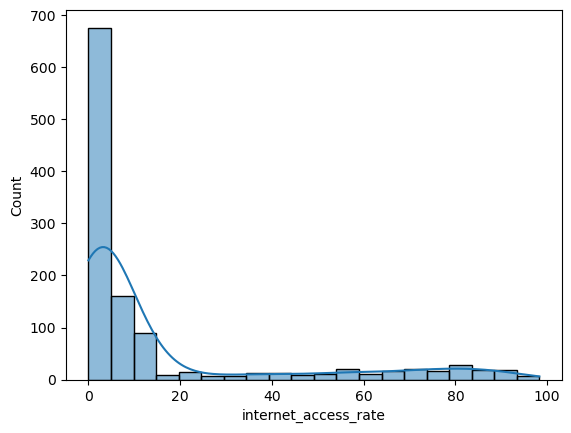

In [25]:
# Extreme value checks
sns.histplot(df_age_grouped['internet_access_rate'], bins=20, kde = True)

There are no extreme values. The most rates are clustered between 0-10%, but there are no peaks or outliers. 

# 5. Plotting a Choropleth

To do the choropleth, I will filter per demographic group and frequency and plot diverse maps. 

## 5.1 Daily Internet Access Rate (Age 16-24)

In [26]:
# Create a data frame with the demographic group and frequency I want to plot

df_16_24_daily = df_age_grouped[(df_age_grouped['demographic_group'] == 'Individuals, 16 to 24 years old') & (df_age_grouped['freq_internet_access'] == 'daily')]

In [27]:
df_16_24_daily.shape

(38, 4)

In [28]:
# Setup a folium map at a high-level zoom
map = folium.Map(location = [54, 15], zoom_start=4, tiles="CartoDB positron")

# Choropleth map
folium.Choropleth(
    geo_data = country_geo,
    data = df_16_24_daily,
    columns = ['country', 'internet_access_rate'],
    key_on = 'feature.properties.name',
    fill_color = 'plasma_r', fill_opacity=0.7, line_opacity=0.5, line_color= 'white',
    nan_fill_color = 'white',
    legend_name = "Daily_internet_access_rate (Age 16-24)").add_to(map)
folium.LayerControl().add_to(map)

map

### Insight:
Countries with the highest daily internet access rates among 16-24 years old are mostly located in Northern and Western Europe (purple), except for Ireland, which lag behind. In contrast, Eastern and Southern countries like Turkey, Romania and Greece show lower access rates (yellow).

## 5.2 Daily Internet Access Rate (Age 25-34)

In [29]:
# Create a data frame with the demographic group and frequency I want to plot

df_25_34_daily = df_age_grouped[(df_age_grouped['demographic_group'] == 'Individuals, 25 to 34 years old') & (df_age_grouped['freq_internet_access'] == 'daily')]

In [30]:
df_25_34_daily.shape

(38, 4)

In [31]:
# Setup a folium map at a high-level zoom
map = folium.Map(location = [54, 15], zoom_start=4, tiles="CartoDB positron")

# Choropleth map
folium.Choropleth(
    geo_data = country_geo,
    data = df_25_34_daily,
    columns = ['country', 'internet_access_rate'],
    key_on = 'feature.properties.name',
    fill_color = 'plasma_r', fill_opacity=0.7, line_opacity=0.5, line_color= 'white',
    nan_fill_color = 'white',
    legend_name = "Daily_internet_access_rate (Age 25-34)").add_to(map)
folium.LayerControl().add_to(map)

map

### Insight:
For the 25-34 age group, daily internet access remain high in Northern and Western Europe (purple), but differences across countries are more pronounced than in the younger group. Turkey, Greece and Romania still show low access rates (yellow). 

## 5.3 Daily Internet Access Rate (Age 35-44)

In [32]:
# Create a data frame with the demographic group and frequency I want to plot

df_35_44_daily = df_age_grouped[(df_age_grouped['demographic_group'] == 'Individuals, 35 to 44 years old') & (df_age_grouped['freq_internet_access'] == 'daily')]

In [33]:
df_35_44_daily.shape

(38, 4)

In [34]:
# Setup a folium map at a high-level zoom
map = folium.Map(location = [54, 15], zoom_start=4, tiles="CartoDB positron")

# Choropleth map
folium.Choropleth(
    geo_data = country_geo,
    data = df_35_44_daily,
    columns = ['country', 'internet_access_rate'],
    key_on = 'feature.properties.name',
    fill_color = 'plasma_r', fill_opacity=0.7, line_opacity=0.5, line_color= 'white',
    nan_fill_color = 'white',
    legend_name = "Daily_internet_access_rate (Age 35-44)").add_to(map)
folium.LayerControl().add_to(map)

map

### Insight:
For the 35-44 age group, daily internet access patterns are very similar to those of the 25-34 years. Northern and Western Europe maintain high access rates (purple), while countries in the East and Southeast like Turkey, Romania and Greece, continue to show lower rates (yellow), suggestiong a digital gap between Southeastern and Northwestern Europe. 

## 5.4 Daily Internet Access Rate (Age 45-54)

In [35]:
# Create a data frame with the demographic group and frequency I want to plot

df_45_54_daily = df_age_grouped[(df_age_grouped['demographic_group'] == 'Individuals, 45 to 54 years old') & (df_age_grouped['freq_internet_access'] == 'daily')]

In [36]:
df_45_54_daily.shape

(38, 4)

In [37]:
# Setup a folium map at a high-level zoom
map = folium.Map(location = [54, 15], zoom_start=4, tiles="CartoDB positron")

# Choropleth map
folium.Choropleth(
    geo_data = country_geo,
    data = df_45_54_daily,
    columns = ['country', 'internet_access_rate'],
    key_on = 'feature.properties.name',
    fill_color = 'plasma_r', fill_opacity=0.7, line_opacity=0.5, line_color= 'white',
    nan_fill_color = 'white',
    legend_name = "Daily_internet_access_rate (Age 45-54)").add_to(map)
folium.LayerControl().add_to(map)

map

### Insight:
For the 45 to 54 age group, the daily internet access decreases compared to younger groups, but the regional pattern stays consistent. Northern Europe maintain high usage rates and Western and Central Europe shows moderate rates, while Southern and Eastern Europe continue to show lower access rates. 

## 5.5 Daily Internet Access Rate (Age 55-64)

In [38]:
# Create a data frame with the demographic group and frequency I want to plot

df_55_64_daily = df_age_grouped[(df_age_grouped['demographic_group'] == 'Individuals, 55 to 64 years old') & (df_age_grouped['freq_internet_access'] == 'daily')]

In [39]:
df_55_64_daily.shape

(38, 4)

In [40]:
# Setup a folium map at a high-level zoom
map = folium.Map(location = [54, 15], zoom_start=4, tiles="CartoDB positron")

# Choropleth map
folium.Choropleth(
    geo_data = country_geo,
    data = df_55_64_daily,
    columns = ['country', 'internet_access_rate'],
    key_on = 'feature.properties.name',
    fill_color = 'plasma_r', fill_opacity=0.7, line_opacity=0.5, line_color= 'white',
    nan_fill_color = 'white',
    legend_name = "Daily_internet_access_rate (Age 55-64)").add_to(map)
folium.LayerControl().add_to(map)

map

### Insight:
For the 55 to 64 age group, daily internet access rates drops more noticeably compared to younger groups, especially in Eastern and Southeastern Europe. Nordin countries have shown the highest rates consistently across age groups. Countries like Turkey, Rumania and Greece remain among the countries with the lowest access rates, reinforcing the regional gap in the digital acces. 

## 5.6 Daily Internet Access Rate (Age 65-74)

In [41]:
# Create a data frame with the demographic group and frequency I want to plot

df_65_74_daily = df_age_grouped[(df_age_grouped['demographic_group'] == 'Individuals, 65 to 74 years old') & (df_age_grouped['freq_internet_access'] == 'daily')]

In [42]:
df_65_74_daily.shape

(38, 4)

In [43]:
# Setup a folium map at a high-level zoom
map = folium.Map(location = [54, 15], zoom_start=4, tiles="CartoDB positron")

# Choropleth map
folium.Choropleth(
    geo_data = country_geo,
    data = df_65_74_daily,
    columns = ['country', 'internet_access_rate'],
    key_on = 'feature.properties.name',
    fill_color = 'plasma_r', fill_opacity=0.7, line_opacity=0.5, line_color= 'white',
    nan_fill_color = 'white',
    legend_name = "Daily_internet_access_rate (Age 65-74)").add_to(map)
folium.LayerControl().add_to(map)

map

### Insight:
For the 65 to 74 age group, the internet access rate declines again compared to younger groups, but the regional patterns remain consistent. These visualizations suggest not only a regional, but also a generational gap in terms of digital access. The older the population, the bigger the regional differences between Northern and Southeastern Europe. 

## 5.7 Daily Internet Access Rate (Age 75+)

In [44]:
# Create a data frame with the demographic group and frequency I want to plot

df_75_daily = df_age_grouped[(df_age_grouped['demographic_group'] == 'Individuals, 75 years old or more') & (df_age_grouped['freq_internet_access'] == 'daily')]

In [45]:
df_75_daily.shape

(16, 4)

In [46]:
df_75_daily

,demographic_group,freq_internet_access,country,internet_access_rate
1118,"Individuals, 75 years old or more",daily,Albania,21.550000
1119,"Individuals, 75 years old or more",daily,Austria,34.890000
1120,"Individuals, 75 years old or more",daily,Belgium,49.560000
1121,"Individuals, 75 years old or more",daily,Croatia,38.550000
1122,"Individuals, 75 years old or more",daily,Czechia,3.241087
1123,"Individuals, 75 years old or more",daily,Finland,3.220000
1124,"Individuals, 75 years old or more",daily,Germany,9.446346
1125,"Individuals, 75 years old or more",daily,Hungary,0.950000
1126,"Individuals, 75 years old or more",daily,Ireland,35.157391
1127,"Individuals, 75 years old or more",daily,Italy,6.964402


In [47]:
# Setup a folium map at a high-level zoom
map = folium.Map(location = [54, 15], zoom_start=4, tiles="CartoDB positron")

# Choropleth map
folium.Choropleth(
    geo_data = country_geo,
    data = df_75_daily,
    columns = ['country', 'internet_access_rate'],
    key_on = 'feature.properties.name',
    fill_color = 'plasma_r', fill_opacity=0.7, line_opacity=0.5, line_color= 'white',
    nan_fill_color = 'white',
    legend_name = "Daily_internet_access_rate (Age 75+)").add_to(map)
folium.LayerControl().add_to(map)

map

### Insight:
For the 75+ age group, the internet access rates drop significantly across Europe, with very few countires reporting high access rates. Overall access is low, and many countries lack data. This emphasizes a strong generational gap in digital access. 

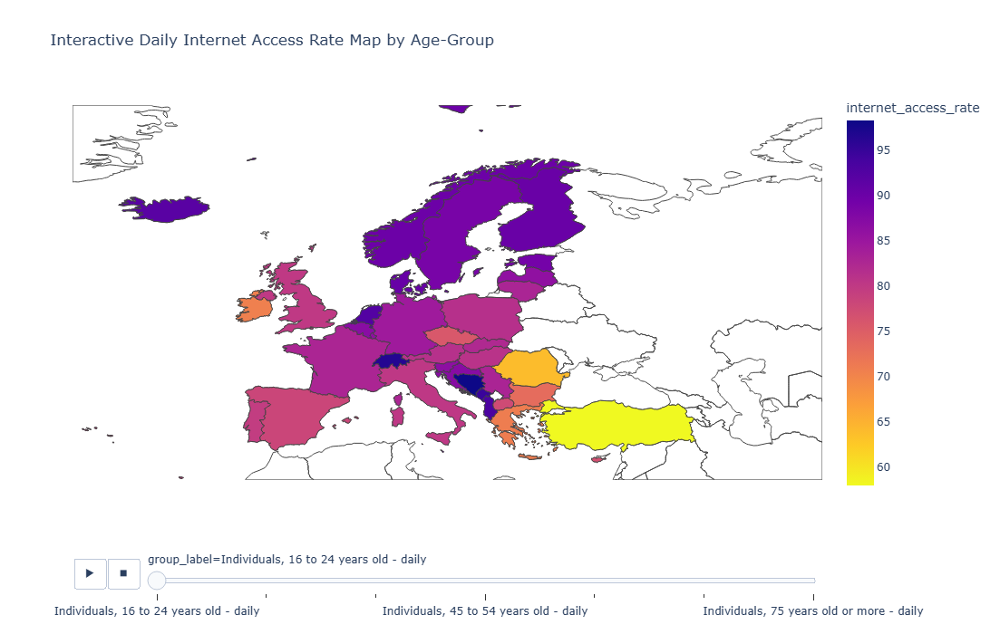

In [90]:
# Create subset for daily frequency and all ages. 
df_daily = df_age_grouped[df_age_grouped['freq_internet_access'] == 'daily'].copy()
# Interactive map of previous maps.

import plotly.express as px

df_daily['group_label'] = df_daily['demographic_group'] + ' - ' + df_daily['freq_internet_access']

fig = px.choropleth(
    df_daily,
    locations="country",
    locationmode="country names",
    color="internet_access_rate",
    hover_name="country",
    animation_frame="group_label", 
    color_continuous_scale='plasma_r',
    title="Interactive Daily Internet Access Rate Map by Age-Group",
    width= 1000,
    height= 700,
    custom_data=['demographic_group', 'internet_access_rate']
)

# Personalize tooltip information
fig.update_traces(
    hovertemplate=
    '<b>%{hovertext}</b><br>' + # hover_name 'country'
    'Age group: %{customdata[0]}<br>' +
    'Internet access rate: %{customdata[1]:.1f}%<br>' +
    '<extra></extra>'
)

# Focus map on Europe
fig.update_geos(
    visible=False,
    resolution=50,
    showcountries=True,
    center={'lat': 55, 'lon': 15}, # Central Europe
    projection_scale=4 #zoom
)
fig.show()

## 5.8 Purchasing Power Adjusted GDP by Country

In [48]:
# Create subset for gdp by country
df_gdp = df.groupby('country')['purchasing_power_gdp'].mean().reset_index()

In [49]:
df_gdp.shape

(38, 2)

In [50]:
df_gdp

,country,purchasing_power_gdp
0,Albania,11349.894835
1,Austria,35831.830274
2,Belgium,33855.519553
3,Bosnia and Herz.,11385.181058
4,Bulgaria,14884.189049
5,Croatia,19159.855238
6,Cyprus,26607.453035
7,Czechia,25098.188969
8,Denmark,36172.134510
9,Estonia,21830.136094


In [80]:
# Setup a folium map at a high-level zoom

# for the pop-up boxes
sate_data_indexed = df_gdp.set_index('country')
state_data_indexed['purchasing_power_gdp'] = state_data_indexed['purchasing_power_gdp'].astype(np.float64)

map = folium.Map(location = [54, 15], zoom_start=4, tiles="CartoDB positron")

# Choropleth map
cp=folium.Choropleth(
    geo_data = country_geo,
    data = df_gdp,
    columns = ['country', 'purchasing_power_gdp'],
    key_on = 'feature.properties.name',
    fill_color = 'plasma_r', fill_opacity=0.7, line_opacity=0.5, line_color= 'white',
    nan_fill_color = 'white',
    legend_name = "Purchasing Power Adjusted GDP by Country").add_to(map)
folium.LayerControl().add_to(map)

for s in cp.geojson.data['features']:
    if s['properties']['name'] in state_data_indexed.index:
        s['properties']['purchasing_power_gdp']=state_data_indexed.loc[s['properties']['name'], 'purchasing_power_gdp']
    else:
        s['properties']['purchasing_power_gdp']=0

folium.GeoJsonTooltip(
    fields=['name', 'purchasing_power_gdp'],
    aliases=['Country:', 'GDP (PPP):'],
    localize=True
).add_to(cp.geojson)

map

### Insight:
Countries in Western and Northern Europe show a higher Purchasing POwer Adjusted GDP, especially Luxembourg, Switzerland, Ireland and Norway. In contrast, countries in Eastern and Souteastern Europe like Turkey, Greece, Bulgaria show considerably lower purchasing power (yellow). This is similar to the digital acces divide seen in previous maps, suggesting a strong correlation between the economic level of a country and the digital inclusion.  

### Geneal Conclusion:
Across the EU Members, both age and economic level play a crucial role in the digital access. 
- Younger age groups (16-34) show high and consistent daily internet access rates across most countries, especially in Northern and Western Europe.
- As age increases, internet access rates decreases significantly, especially in the Eastern and Southeastern Europe, suggesting a double gap (generational and regional).
- The map of Purchasing Power Adjusted GDP shows the same regional pattern: Countries with lower GDP per capita tend to have lower internet access rates, particularly among older populations.
- This suggests that economic strenght supports better digial infrastructure and inclusion. 